<a href="https://colab.research.google.com/github/rymketata/black-and-white-colorization/blob/main/black_and_white_colorization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

>  **Image Colorization with Conditional GAN**

**Introduction**

**Config Class**

In [1]:
class Config:
    external_data_size = 10000
    train_size = 8000
    image_size_1 = 256
    image_size_2 = 256
    batch_size = 32
    LeakyReLU_slope = 0.2
    dropout = 0.5
    kernel_size = 4
    stride = 2
    padding = 1
    gen_lr = 2e-4
    disc_lr = 2e-4
    beta1 = 0.5
    beta2 = 0.999
    lambda_l1 = 100
    gan_mode = 'vanilla'
    layers_to_cut = -2
    epochs = 20
    pretrain_lr = 1e-4

**Importing Packages**

In [2]:
import sys
print(sys.version)


3.10.11 (main, Apr  5 2023, 14:15:10) [GCC 9.4.0]


In [3]:
#@title
!sudo apt-get install python3.7
!sudo apt-get update -y
!sudo update-alternatives --install /usr/bin/python3 python3/usr/bin/python3.7 1
!sudo update-alternatives --config python3


Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libpython3.7-minimal libpython3.7-stdlib python3.7-minimal
Suggested packages:
  python3.7-venv binfmt-support
The following NEW packages will be installed:
  libpython3.7-minimal libpython3.7-stdlib python3.7 python3.7-minimal
0 upgraded, 4 newly installed, 0 to remove and 24 not upgraded.
Need to get 4,530 kB of archives.
After this operation, 23.3 MB of additional disk space will be used.
Get:1 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal/main amd64 libpython3.7-minimal amd64 3.7.16-1+focal1 [588 kB]
Get:2 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal/main amd64 python3.7-minimal amd64 3.7.16-1+focal1 [1,808 kB]
Get:3 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal/main amd64 libpython3.7-stdlib amd64 3.7.16-1+focal1 [1,773 kB]
Get:4 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal/main amd64 python3.7 amd64 3.

In [4]:
print(sys.version)


3.10.11 (main, Apr  5 2023, 14:15:10) [GCC 9.4.0]


In [5]:
!apt-get install python3-pip

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  python-pip-whl python3-setuptools python3-wheel
Suggested packages:
  python-setuptools-doc
The following NEW packages will be installed:
  python-pip-whl python3-pip python3-setuptools python3-wheel
0 upgraded, 4 newly installed, 0 to remove and 29 not upgraded.
Need to get 2,389 kB of archives.
After this operation, 4,933 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python-pip-whl all 20.0.2-5ubuntu1.8 [1,805 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal-updates/main amd64 python3-setuptools all 45.2.0-1ubuntu0.1 [330 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python3-wheel all 0.34.2-1ubuntu0.1 [23.9 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python3-pip all 20.0.2-5ubuntu1.8 [231 kB]
Fetched 2,389 kB in 1s (2,

In [6]:
 !pip uninstall torch torchvision --yes
 !pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/cu111/torch_stable.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/cu111/torch_stable.html
     |████████████████████████████████| 2041.3 MB 2.7 kB/s 
     |████████████████████████████████| 23.2 MB 1.2 MB/s 
     |████████████████████████████████| 3.3 MB 26.1 MB/s 
     |████████████████████████████████| 17.3 MB 65.4 MB/s 


In [7]:
# !pip uninstall torchaudio --yes
!pip install torchaudio==0.8.1
# !pip uninstall protobuf --yes
!pip install protobuf==3.20.0
# !pip uninstall allennlp --yes
!pip install allennlp==2.10.0 torch<1.12.0,>=1.10.0


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 13.4 MB/s 
     |████████████████████████████████| 804.1 MB 5.9 kB/s 
ERROR: torchvision 0.10.0+cu111 has requirement torch==1.9.0, but you'll have torch 1.8.1 which is incompatible.
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu111
    Uninstalling torch-1.9.0+cu111:
      Successfully uninstalled torch-1.9.0+cu111
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 13.6 MB/s 
/bin/bash: 1.12.0,: No such file or directory


In [8]:
import os
from pathlib import Path
import glob
import time
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm import tqdm

import PIL
from PIL import Image
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.models.resnet import resnet18
from torchvision.models.vgg import vgg19
from torch.utils.data import Dataset, DataLoader

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [9]:
! pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 63 kB 1.8 MB/s 
     |████████████████████████████████| 156 kB 29.4 MB/s 
     |████████████████████████████████| 247 kB 60.6 MB/s 
     |████████████████████████████████| 62 kB 1.2 MB/s 
     |████████████████████████████████| 77 kB 6.9 MB/s 
     |████████████████████████████████| 123 kB 80.0 MB/s 
     |████████████████████████████████| 78 kB 8.1 MB/s 
     |████████████████████████████████| 61 kB 106 kB/s 
     |████████████████████████████████| 195 kB 84.3 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.13-py3-none-any.whl size=77720 sha256=1eceb7b5108e4e9fcb677d9d69e6e710b7051e2c8dd60805320abc4265036181
  Stored in directory: /root/.cache/pip/wheels/e6/8e/67/e07554a720a493dc6b39b30488590ba92ed45448ad0134d253
Successfully built kaggle


In [10]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [11]:
! mkdir ~/.kaggle

In [12]:
!wget -O ~/.kaggle/kaggle.json https://raw.githubusercontent.com/rymketata/black-and-white-colorization/main/kaggle.json

--2023-05-14 16:00:54--  https://raw.githubusercontent.com/rymketata/black-and-white-colorization/main/kaggle.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2023-05-14 16:00:54 ERROR 404: Not Found.



In [13]:
!chmod 600 ~/.kaggle/kaggle.json

In [14]:
!kaggle datasets download -d shravankumar9892/image-colorization --force
!kaggle datasets download -d awsaf49/coco-2017-dataset --force
!kaggle competitions download -c gan-getting-started --force


Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.8/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.8/dist-packages/kaggle/api/kaggle_api_extended.py", line 169, in authenticate
    self._load_config(config_data)
  File "/usr/local/lib/python3.8/dist-packages/kaggle/api/kaggle_api_extended.py", line 210, in _load_config
    raise ValueError('Error: Missing %s in configuration.' % item)
ValueError: Error: Missing username in configuration.
Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 5, in <module>
    from kaggle.cli import main
  File "/usr/local/lib/python3.8/dist-packages/kaggle/__init__.py", line 23, in <module>
    api.authenticate()
  File "/usr/local/lib/python3.8/dist-packages/kaggle/api/kaggle_api_extended.py", line 169, in authenticate
    self._load_config(config_data)
  File "/usr/local/l

In [15]:
!mkdir Dataset

In [16]:
ls 
ls Dataset/

Dataset/  drive/  sample_data/


In [17]:
!unzip -q /content/image-colorization.zip -d /content/Dataset
!unzip -q /content/gan-getting-started.zip -d /content/Dataset
!unzip -q /content/coco-2017-dataset.zip -d /content/Dataset


cp: cannot stat '/content/image-colorization.zip': No such file or directory
cp: cannot stat '/content/gan-getting-started.zip': No such file or directory
cp: cannot stat '/content/coco-2017-dataset.zip': No such file or directory


In [18]:
ls Dataset/
ls


In [20]:
!rm /content/Dataset/gan-getting-started.zip
!rm /content/Dataset/image-colorization.zip
!rm /content/Dataset/coco-2017-dataset.zip

rm: cannot remove '/content/Dataset/gan-getting-started.zip': No such file or directory
rm: cannot remove '/content/Dataset/image-colorization.zip': No such file or directory
rm: cannot remove '/content/Dataset/coco-2017-dataset.zip': No such file or directory


In [21]:
ls Dataset/

**FastAI imports + Loading in the Data**

The data is a small sample of the COCO dataset for object detection and is loaded in through the external data functionality of fastai.

In [49]:
!pip install fastai==2.4
from fastai.vision.learner import create_body
from fastai.vision.models.unet import DynamicUnet
from fastai.data.external import untar_data, URLs
from fastai.vision.models import resnet18
from fastai.vision.learner import create_body


path = untar_data(URLs.COCO_SAMPLE)
print(path)
path = str(path) + "/train_sample"
paths = glob.glob(path + "/*.jpg")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/root/.fastai/data/coco_sample


In [50]:
# Train test split
np.random.seed(42)
paths_subset = np.random.choice(paths, Config.external_data_size, replace=False) # choosing 10000 images randomly
random_idxs = np.random.permutation(Config.external_data_size) 
train_idxs = random_idxs[:Config.train_size] # choosing the first 8000 as training set
val_idxs = random_idxs[Config.train_size:] # choosing last 2000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

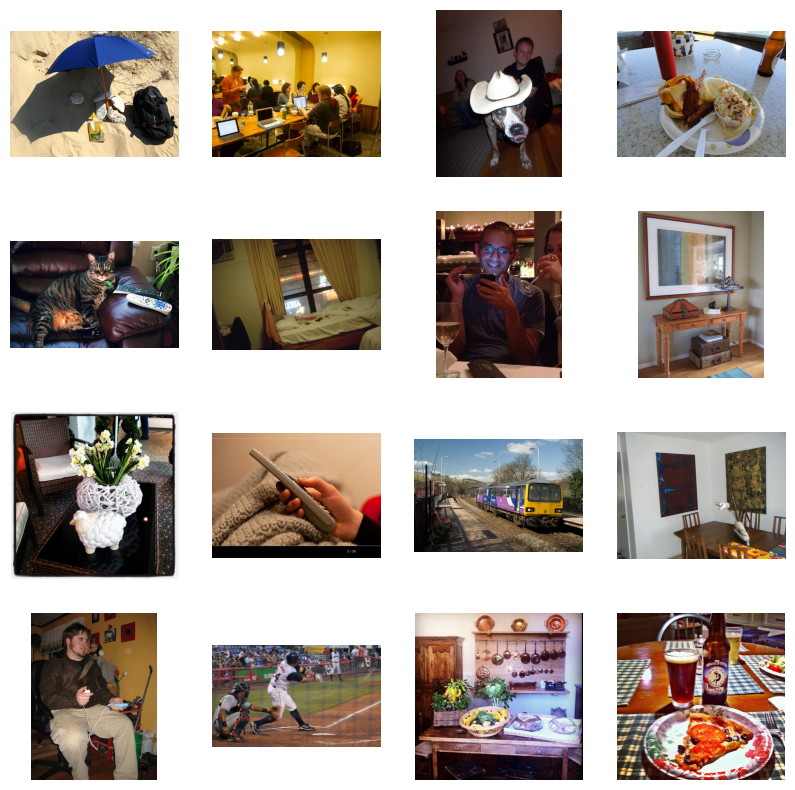

In [51]:
# Taking a look at the training dataset
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [52]:
class ImageDataset(Dataset):
    ''' 
    
    Class that deals with the Data Loading and preprocessing steps such as image resizing, data augmentation (horizontal flip) 
    and conversion of RGB image to LAB color space with standardization.
    
    '''
    
    def __init__(self,paths,train = True):
        if train == True:
            self.transforms = transforms.Compose([transforms.Resize((Config.image_size_1,Config.image_size_2)),
                                                 transforms.RandomHorizontalFlip()]) # Basic Data Augmentation
        elif train == False:
            self.transforms = transforms.Compose([transforms.Resize((Config.image_size_1,Config.image_size_2))])
            
        self.train = train
        self.paths = paths
        
    def __len__(self):
        return len(self.paths)
    
    def __getitem__(self,idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        lab = rgb2lab(img).astype("float32")
        lab = transforms.ToTensor()(lab)
        L = lab[[0],...]/50 - 1 # Standardizing L space
        ab = lab[[1,2],...]/128 # Standardizing ab space
        
        return {'L': L,
                'ab': ab}

In [53]:
batch_size = Config.batch_size

#train dataset
train_data = ImageDataset(paths = train_paths, train=True)
# validation dataset
valid_data = ImageDataset(paths = val_paths, train=False)
# train data loader
train_loader = DataLoader(train_data, batch_size=batch_size,shuffle=True,pin_memory = True)
# validation data loader
valid_loader = DataLoader(valid_data, batch_size=batch_size,shuffle=False,pin_memory = True)

**Utility Functions**



In [54]:

class AverageMeter:
    '''
    
    Computes and stores the average and current value for the various losses involved.
    
    '''
    
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    disc_loss_gen = AverageMeter()
    disc_loss_real = AverageMeter()
    disc_loss = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'disc_loss_gen': disc_loss_gen,
            'disc_loss_real': disc_loss_real,
            'disc_loss': disc_loss,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)
        


def lab_to_rgb(L, ab):
    """
    
    Takes a batch of images and converts from LAB space to RGB
    
    """
    
    L = (L + 1.) * 50
    ab = ab * 128
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    '''
    
    Function which helps visualize and see the difference between the input image (grayscale), generated image 
    and the Real image.
    
    '''
    
    model.generator.eval()
    with torch.no_grad():
        model.prepare_input(data)
        model.forward()
#     model.generator.train()
    fake_color = model.gen_output.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")
        

class GANLoss(nn.Module):
    '''
    
    Class that defines the GAN loss.
    
    '''
    
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

**The Generator**

<p>This code implements a U-Net to be used as the generator of our GAN. The code is designed in a manner where we first build the middle part of the U-Net and then build the downsampling and upsampling modules around it. In our Final Modified implementation of this paper we use a resnet as the backbone of our generator in the downsampling module.</p>

In [55]:
# Code help for model architecture and training loop: https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix

class UnetBlock(nn.Module):
    '''
    
    Class that helps define the various different types of blocks used in the Generator architecture
    
    '''
    
    def __init__(self, nf, ni, submodule=None, input_channels=None, dropout=False,innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_channels is None: 
            input_channels = nf
        downconv = nn.Conv2d(input_channels, ni, kernel_size=Config.kernel_size, stride=Config.stride, padding=Config.padding, bias=False)
        downrelu = nn.LeakyReLU(Config.LeakyReLU_slope, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf,kernel_size=Config.kernel_size, stride=Config.stride, padding=Config.padding)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=Config.kernel_size, stride=Config.stride, padding=Config.padding, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=Config.kernel_size, stride=Config.stride, padding=Config.padding, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(Config.dropout)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    '''
    
    The Generator Model Class
    
    '''
    
    def __init__(self, input_channels=1, output_channels=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_channels, out_filters, input_channels=input_channels, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

**The Discriminator**

<p>The discriminator being used here is working on small patches of the images instead of the image as a whole. This code implements a model by stacking blocks of Conv-BatchNorm-LeackyReLU to decide whether the input image is fake or real. </p>

In [56]:
class Discriminator(nn.Module):
    '''
    
    The Discriminator Model Class
    
    '''
    
    def __init__(self,input_channels,num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_channels,num_filters,norm = False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), stride=1 if i == (n_down-1) else 2) for i in range(n_down)]
        model += [self.get_layers(num_filters * 2 ** n_down, 1, stride=1, norm=False, activation=False)] 
        self.model = nn.Sequential(*model)
    
    def get_layers(self, ni, nf, kernel_size=Config.kernel_size, stride=Config.stride, padding=Config.padding, norm=True, activation=True): 
        layers = [nn.Conv2d(ni, nf, kernel_size, stride, padding, bias=not norm)]          
        if norm: 
            layers += [nn.BatchNorm2d(nf)]
        if activation:
            layers += [nn.LeakyReLU(Config.LeakyReLU_slope, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [57]:
# Normal Weight Initialization with mean = 0, std = 0.02

def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

**The Main Model**


In [62]:
def build_backbone_unet(input_channels=1, output_channels=2, size=Config.image_size_1):
    '''
    
    Function that helps build the generator backbone using another pretrained model trained on imagenet for image classification
    
    '''
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18(pretrained=True), n_in=input_channels, cut=Config.layers_to_cut)
    generator = DynamicUnet(body, output_channels, (size, size)).to(device)
    return generator


def pretrain_generator(generator, train_dl, opt, criterion, epochs):
    '''
    
    Function to pretrain the generator in a supervised manner on the colorization task using L1 Loss.
    
    '''
    
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = generator(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

In [63]:
class MainModel(nn.Module):
    '''
    
    The Class where it all comes together.
    
    '''
    
    def __init__(self,generator = None,gen_lr =Config.gen_lr,disc_lr = Config.disc_lr, beta1 = Config.beta1,beta2 = Config.beta2, lambda_l1 = Config.lambda_l1):
        super().__init__()
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_l1 = lambda_l1
        
        if generator is None:
            self.generator = init_model(Unet(input_channels=1, output_channels=2, n_down=8, num_filters=64),self.device)
        else:
            self.generator = generator.to(self.device)
        self.discriminator = init_model(Discriminator(input_channels = 3,num_filters = 64,n_down = 3),self.device)
        self.GANloss = GANLoss(gan_mode=Config.gan_mode).to(self.device)
        self.L1loss = nn.L1Loss()
        self.gen_optim = optim.Adam(self.generator.parameters(), lr=gen_lr, betas=(beta1, beta2))
        self.disc_optim= optim.Adam(self.discriminator.parameters(), lr=disc_lr, betas=(beta1, beta2))
        
    def requires_grad(self,model,requires_grad = True):
        for p in model.parameters():
            p.requires_grad = requires_grad
            
    def prepare_input(self,data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.gen_output = self.generator(self.L)
        
    def disc_backward(self):
        gen_image = torch.cat([self.L, self.gen_output], dim=1)
        gen_image_preds = self.discriminator(gen_image.detach())
        self.disc_loss_gen = self.GANloss(gen_image_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.discriminator(real_image)
        self.disc_loss_real = self.GANloss(real_preds, True)
        self.disc_loss = (self.disc_loss_gen + self.disc_loss_real) * 0.5
        self.disc_loss.backward()
    
    def gen_backward(self):
        gen_image = torch.cat([self.L, self.gen_output], dim=1)
        gen_image_preds = self.discriminator(gen_image)
        self.loss_G_GAN = self.GANloss(gen_image_preds, True)
        self.loss_G_L1 = self.L1loss(self.gen_output, self.ab) * self.lambda_l1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.discriminator.train()
        self.requires_grad(self.discriminator, True)
        self.disc_optim.zero_grad()
        self.disc_backward()
        self.disc_optim.step()
        
        self.generator.train()
        self.requires_grad(self.discriminator, False) 
        self.gen_optim.zero_grad()
        self.gen_backward()
        self.gen_optim.step()

**Training Function**

In [64]:
def train_model(model, train_loader, epochs, display=100):
    data = next(iter(train_loader)) 
    for epoch in range(epochs):
        loss_meter_dict = create_loss_meters() 
        i=0
        for data in tqdm(train_loader):
            model.prepare_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) 
            i+=1
            if i % display == 0:
                print(f"\nEpoch {epoch+1}/{epochs}")
                print(f"Iteration {i}/{len(train_loader)}")
                log_results(loss_meter_dict) 
                visualize(model, data, save=False) 

**Let's Go**

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 189MB/s]
100%|██████████| 250/250 [08:22<00:00,  2.01s/it]


Epoch 1/20
L1 Loss: 0.07659


100%|██████████| 250/250 [08:21<00:00,  2.01s/it]


Epoch 2/20
L1 Loss: 0.07121


100%|██████████| 250/250 [08:16<00:00,  1.99s/it]


Epoch 3/20
L1 Loss: 0.07042


100%|██████████| 250/250 [08:15<00:00,  1.98s/it]


Epoch 4/20
L1 Loss: 0.06999


100%|██████████| 250/250 [08:14<00:00,  1.98s/it]


Epoch 5/20
L1 Loss: 0.06954


100%|██████████| 250/250 [08:13<00:00,  1.97s/it]


Epoch 6/20
L1 Loss: 0.06919


100%|██████████| 250/250 [08:15<00:00,  1.98s/it]


Epoch 7/20
L1 Loss: 0.06869


100%|██████████| 250/250 [08:16<00:00,  1.99s/it]


Epoch 8/20
L1 Loss: 0.06831


100%|██████████| 250/250 [08:15<00:00,  1.98s/it]


Epoch 9/20
L1 Loss: 0.06795


100%|██████████| 250/250 [08:15<00:00,  1.98s/it]


Epoch 10/20
L1 Loss: 0.06746


100%|██████████| 250/250 [08:13<00:00,  1.98s/it]


Epoch 11/20
L1 Loss: 0.06684


100%|██████████| 250/250 [08:13<00:00,  1.97s/it]


Epoch 12/20
L1 Loss: 0.06592


100%|██████████| 250/250 [08:13<00:00,  1.97s/it]


Epoch 13/20
L1 Loss: 0.06535


100%|██████████| 250/250 [08:13<00:00,  1.97s/it]


Epoch 14/20
L1 Loss: 0.06459


100%|██████████| 250/250 [08:13<00:00,  1.97s/it]


Epoch 15/20
L1 Loss: 0.06322


100%|██████████| 250/250 [08:12<00:00,  1.97s/it]


Epoch 16/20
L1 Loss: 0.06229


100%|██████████| 250/250 [08:39<00:00,  2.08s/it]


Epoch 17/20
L1 Loss: 0.06136


100%|██████████| 250/250 [09:03<00:00,  2.18s/it]


Epoch 18/20
L1 Loss: 0.06001


100%|██████████| 250/250 [08:58<00:00,  2.15s/it]


Epoch 19/20
L1 Loss: 0.05926


100%|██████████| 250/250 [08:58<00:00,  2.15s/it]


Epoch 20/20
L1 Loss: 0.05844
model initialized with norm initialization


 40%|███▉      | 99/250 [04:32<06:49,  2.71s/it]


Epoch 1/20
Iteration 100/250
disc_loss_gen: 0.64874
disc_loss_real: 0.68191
disc_loss: 0.66532
loss_G_GAN: 0.96368
loss_G_L1: 6.81670
loss_G: 7.78038


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 54 pixels
  return func(*args, **kwargs)


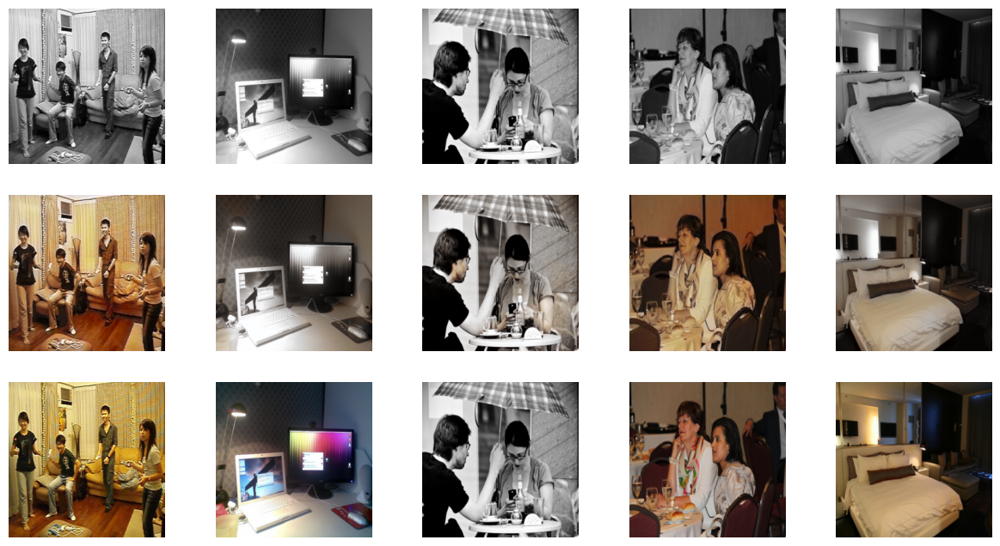

 80%|███████▉  | 199/250 [09:08<02:24,  2.83s/it]


Epoch 1/20
Iteration 200/250
disc_loss_gen: 0.62593
disc_loss_real: 0.63810
disc_loss: 0.63201
loss_G_GAN: 1.00998
loss_G_L1: 6.83350
loss_G: 7.84348


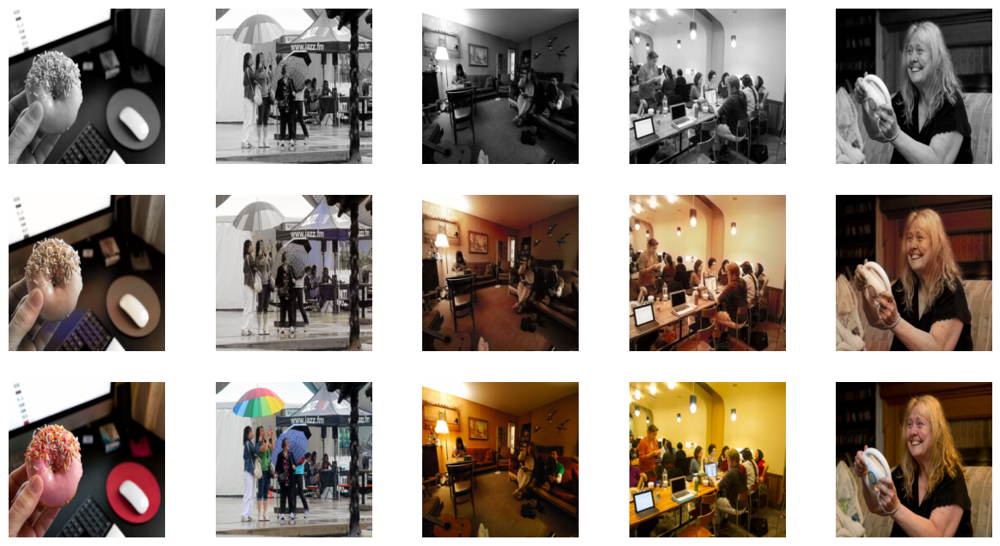

 40%|███▉      | 99/250 [04:31<06:49,  2.71s/it]


Epoch 2/20
Iteration 100/250
disc_loss_gen: 0.37503
disc_loss_real: 0.39716
disc_loss: 0.38609
loss_G_GAN: 1.96076
loss_G_L1: 6.77145
loss_G: 8.73221


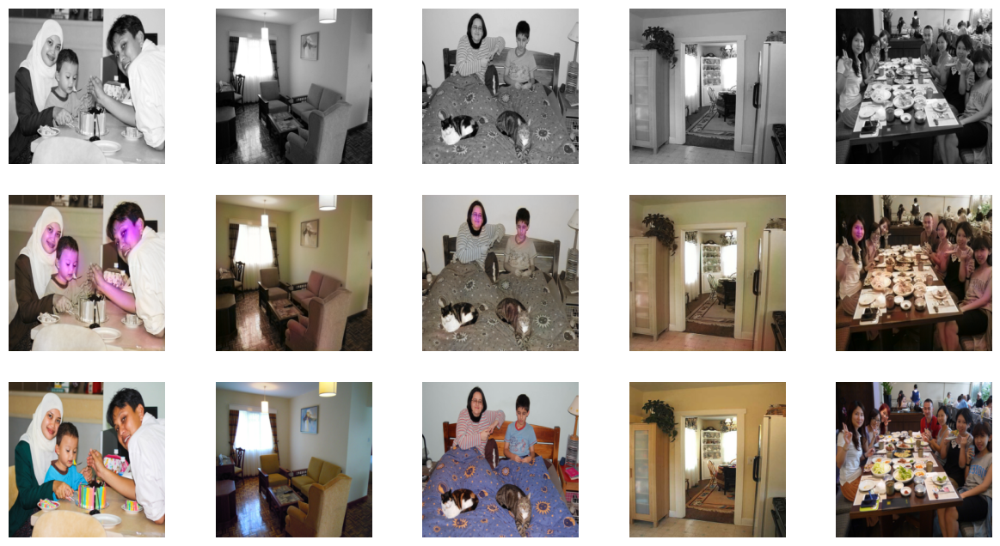

 80%|███████▉  | 199/250 [09:08<02:23,  2.82s/it]


Epoch 2/20
Iteration 200/250
disc_loss_gen: 0.49483
disc_loss_real: 0.50387
disc_loss: 0.49935
loss_G_GAN: 1.54646
loss_G_L1: 6.90508
loss_G: 8.45154


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)


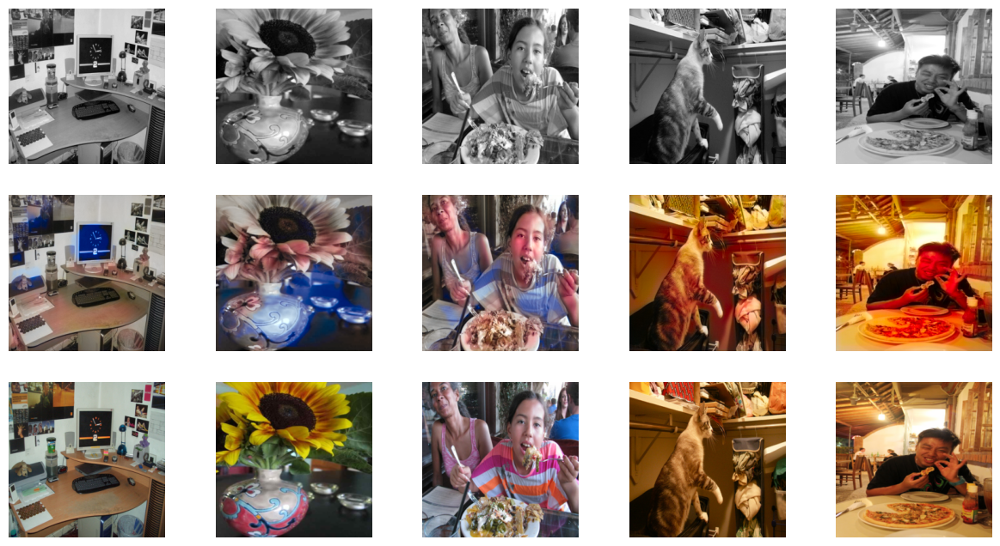

 40%|███▉      | 99/250 [04:31<06:49,  2.71s/it]


Epoch 3/20
Iteration 100/250
disc_loss_gen: 0.63057
disc_loss_real: 0.62147
disc_loss: 0.62602
loss_G_GAN: 1.02152
loss_G_L1: 7.09158
loss_G: 8.11310


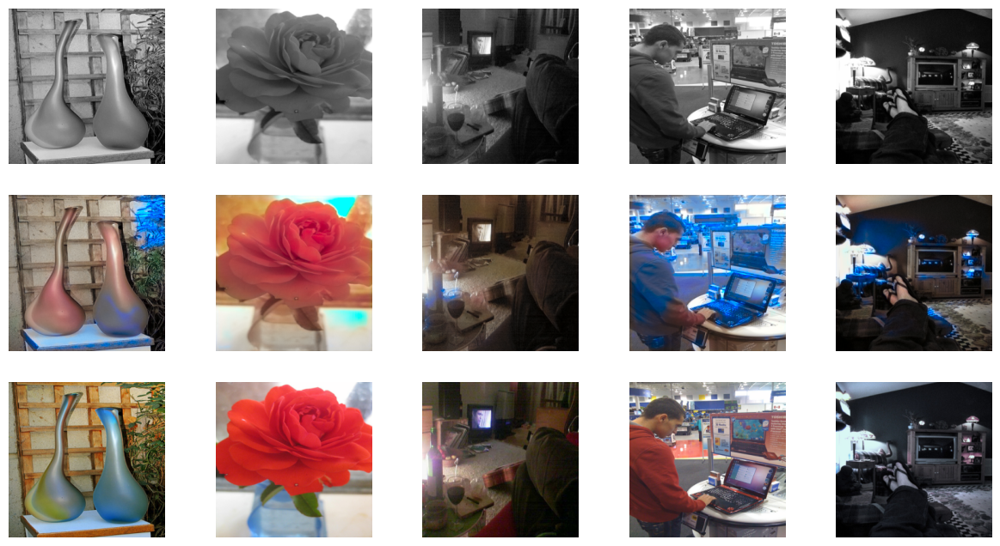

 80%|███████▉  | 199/250 [09:08<02:24,  2.83s/it]


Epoch 3/20
Iteration 200/250
disc_loss_gen: 0.63006
disc_loss_real: 0.62134
disc_loss: 0.62570
loss_G_GAN: 1.02732
loss_G_L1: 7.10210
loss_G: 8.12942


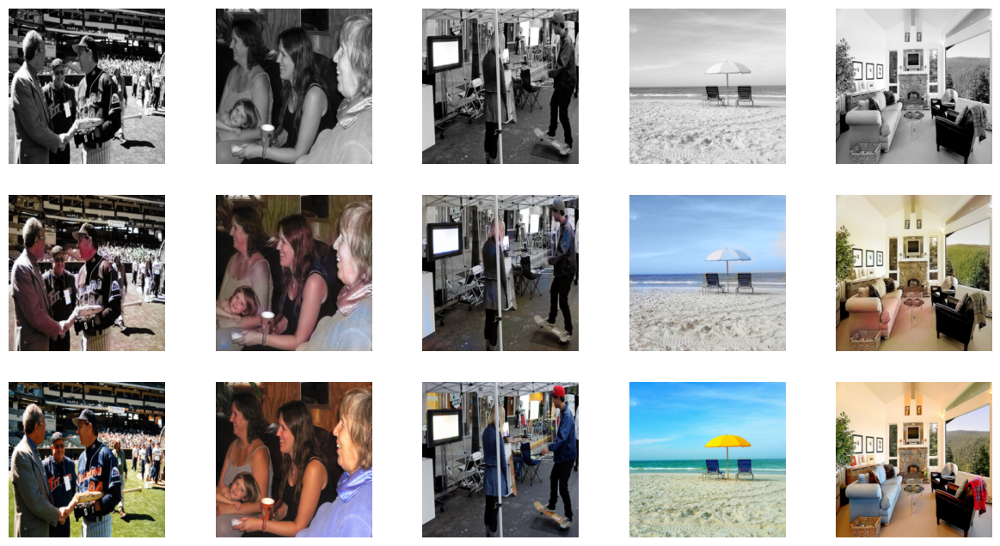

 40%|███▉      | 99/250 [04:32<06:57,  2.76s/it]


Epoch 4/20
Iteration 100/250
disc_loss_gen: 0.62346
disc_loss_real: 0.63047
disc_loss: 0.62697
loss_G_GAN: 0.97060
loss_G_L1: 6.85785
loss_G: 7.82845


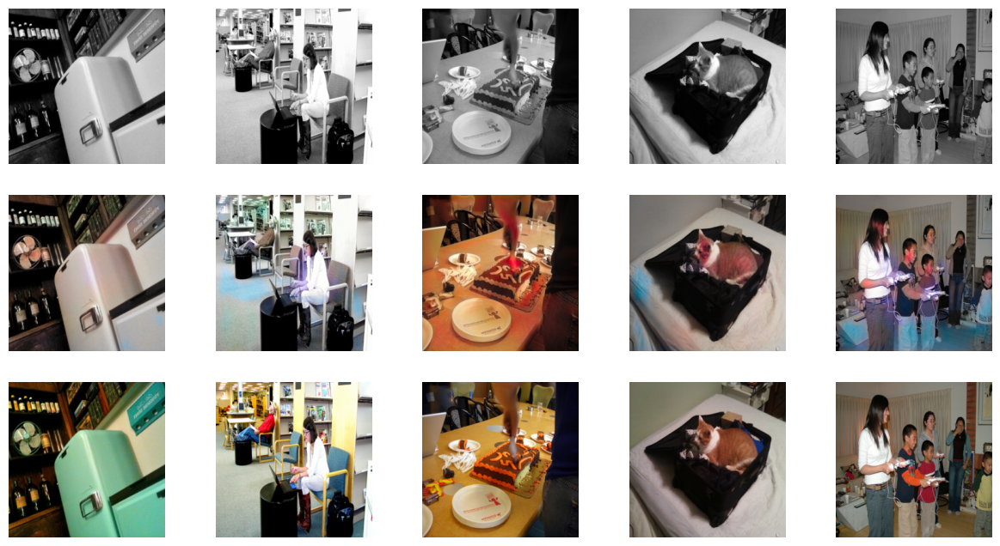

 80%|███████▉  | 199/250 [09:10<02:23,  2.82s/it]


Epoch 4/20
Iteration 200/250
disc_loss_gen: 0.61652
disc_loss_real: 0.63662
disc_loss: 0.62657
loss_G_GAN: 0.98644
loss_G_L1: 6.89546
loss_G: 7.88191


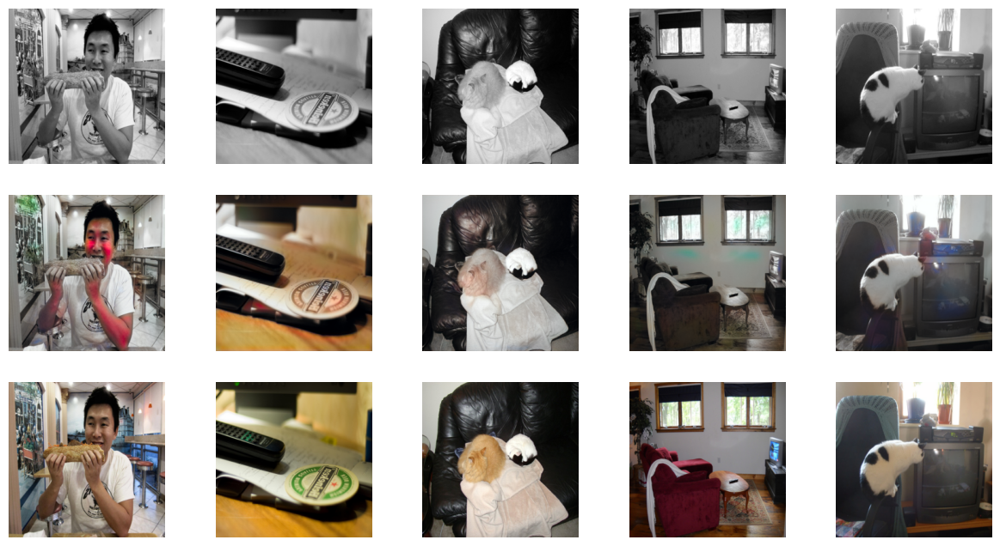

 40%|███▉      | 99/250 [04:34<07:06,  2.82s/it]


Epoch 5/20
Iteration 100/250
disc_loss_gen: 0.61961
disc_loss_real: 0.62185
disc_loss: 0.62073
loss_G_GAN: 1.03413
loss_G_L1: 6.87766
loss_G: 7.91179


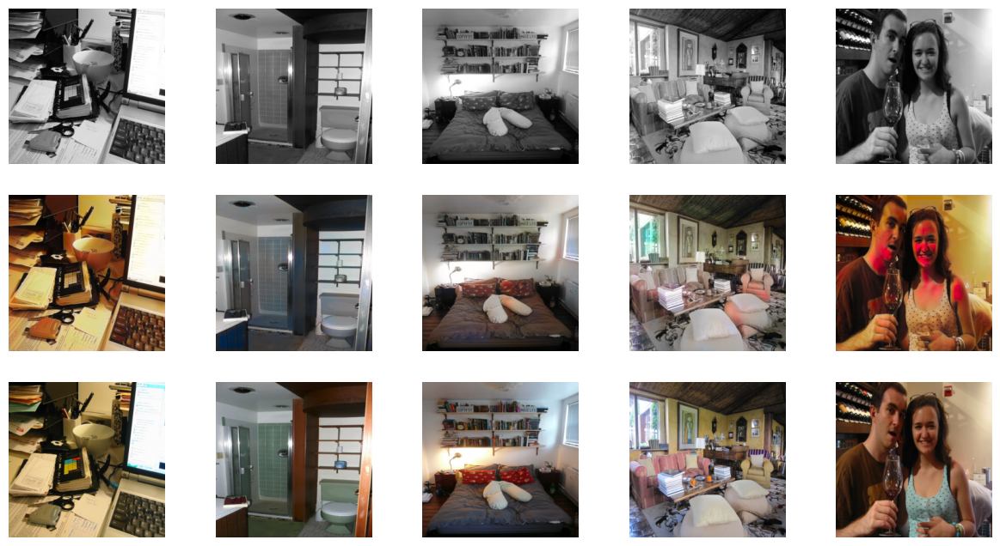

 80%|███████▉  | 199/250 [09:12<02:21,  2.77s/it]


Epoch 5/20
Iteration 200/250
disc_loss_gen: 0.61581
disc_loss_real: 0.62882
disc_loss: 0.62232
loss_G_GAN: 1.01411
loss_G_L1: 6.87033
loss_G: 7.88443


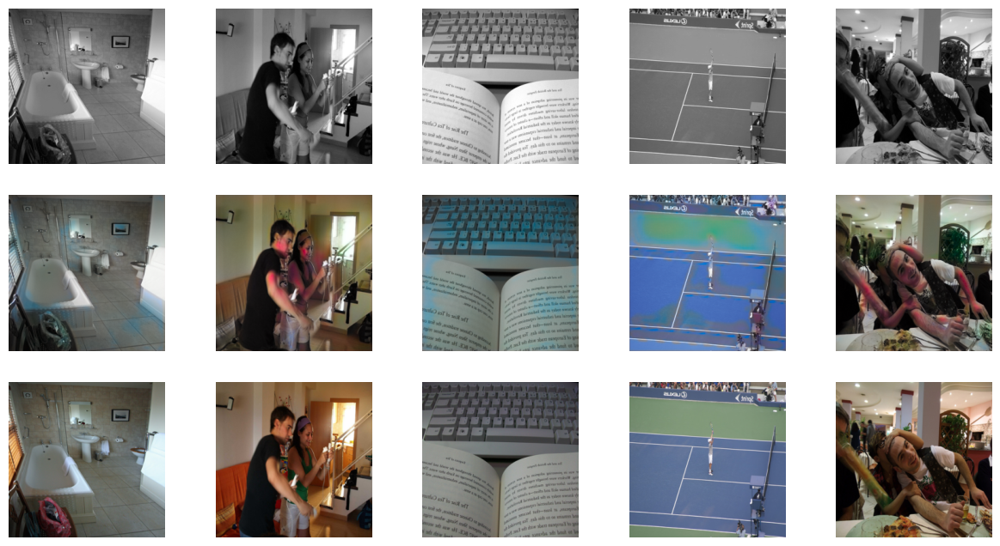

 40%|███▉      | 99/250 [04:35<07:00,  2.79s/it]


Epoch 6/20
Iteration 100/250
disc_loss_gen: 0.61928
disc_loss_real: 0.61904
disc_loss: 0.61916
loss_G_GAN: 0.97558
loss_G_L1: 6.95657
loss_G: 7.93215


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 52 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 63 pixels
  return func(*args, **kwargs)


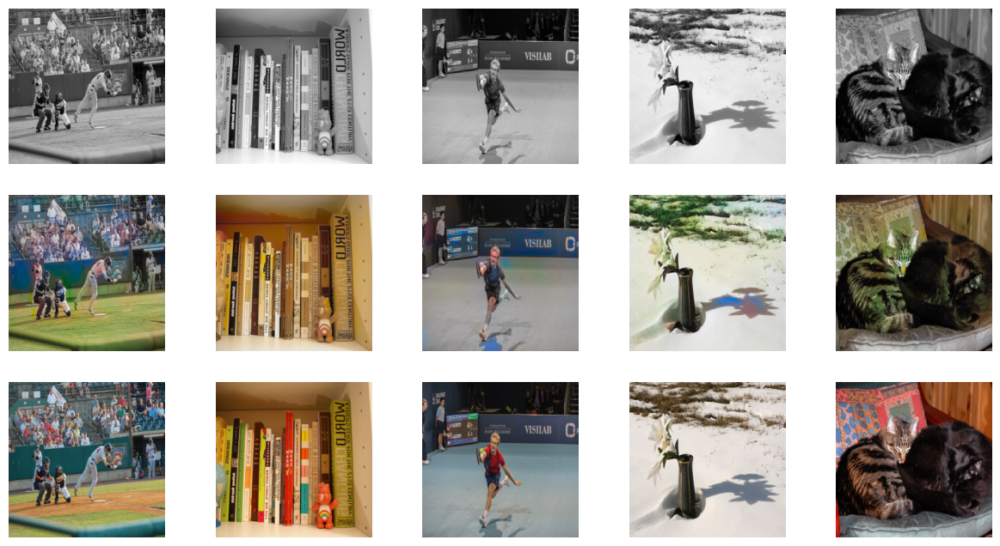

 80%|███████▉  | 199/250 [09:16<02:18,  2.72s/it]


Epoch 6/20
Iteration 200/250
disc_loss_gen: 0.62113
disc_loss_real: 0.62287
disc_loss: 0.62200
loss_G_GAN: 0.97400
loss_G_L1: 6.83519
loss_G: 7.80919


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 136 pixels
  return func(*args, **kwargs)


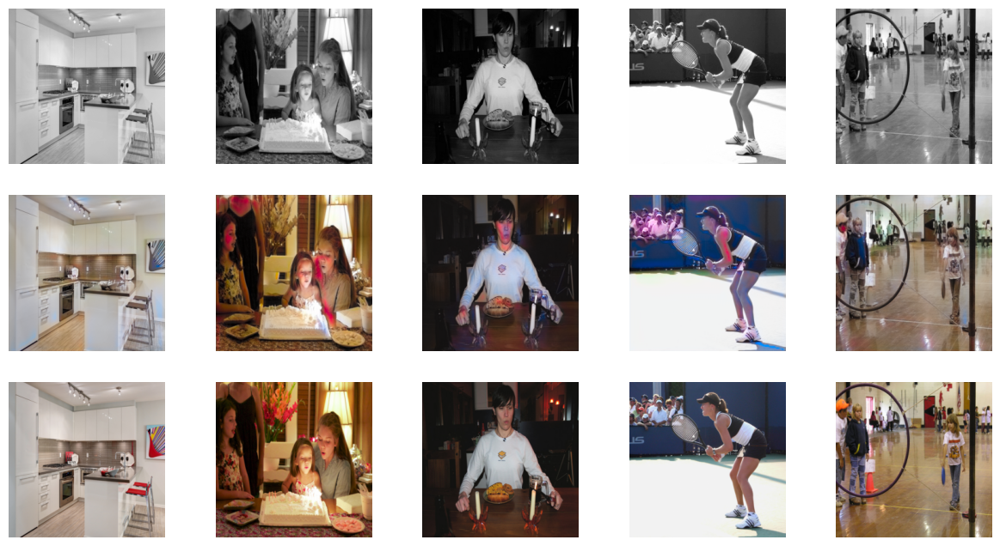

 40%|███▉      | 99/250 [04:32<06:44,  2.68s/it]


Epoch 7/20
Iteration 100/250
disc_loss_gen: 0.62829
disc_loss_real: 0.61484
disc_loss: 0.62157
loss_G_GAN: 0.95649
loss_G_L1: 6.79305
loss_G: 7.74953


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 44 pixels
  return func(*args, **kwargs)


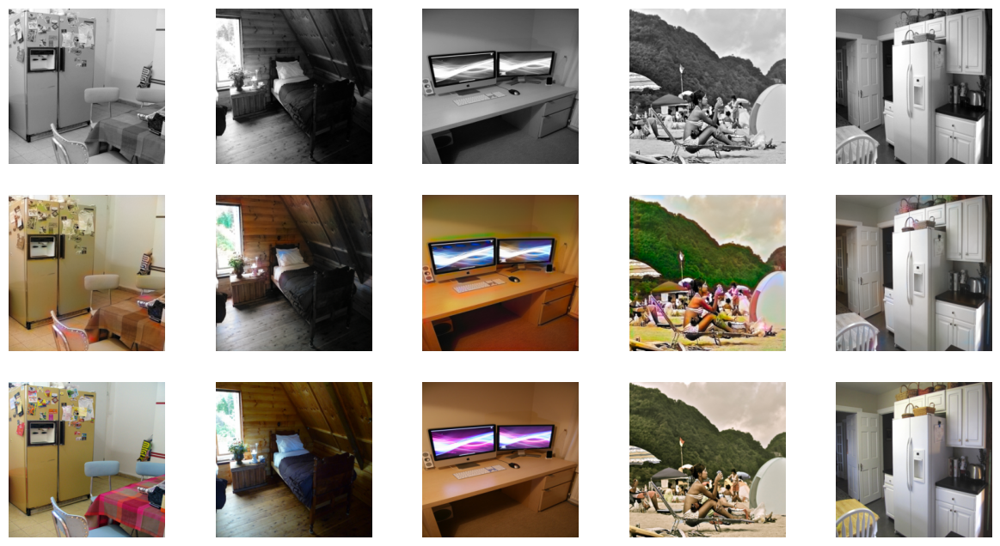

 80%|███████▉  | 199/250 [09:13<02:20,  2.75s/it]


Epoch 7/20
Iteration 200/250
disc_loss_gen: 0.62197
disc_loss_real: 0.62387
disc_loss: 0.62292
loss_G_GAN: 0.96858
loss_G_L1: 6.69368
loss_G: 7.66226


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 79 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 70 pixels
  return func(*args, **kwargs)


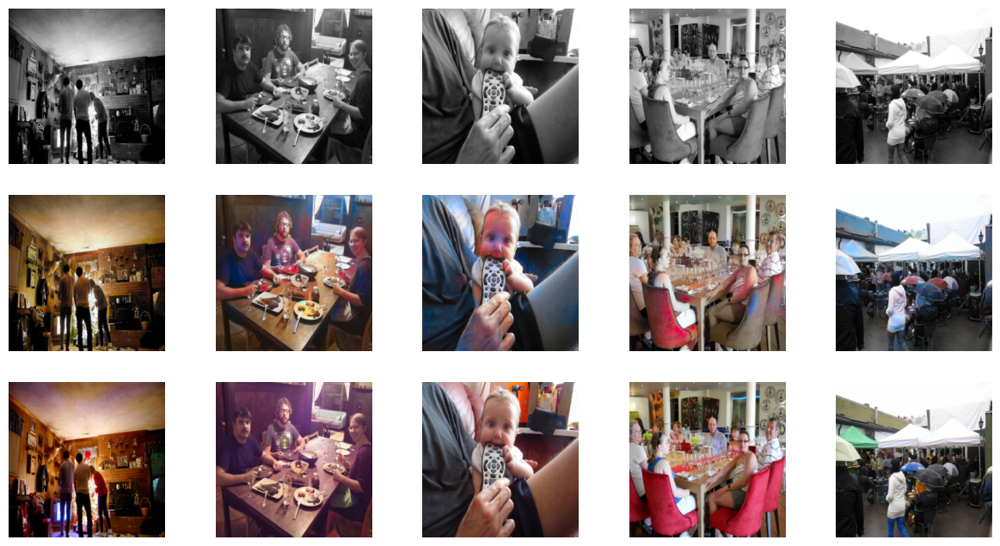

 40%|███▉      | 99/250 [04:33<06:48,  2.70s/it]


Epoch 8/20
Iteration 100/250
disc_loss_gen: 0.62134
disc_loss_real: 0.64305
disc_loss: 0.63219
loss_G_GAN: 0.94671
loss_G_L1: 6.61710
loss_G: 7.56382


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 90 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 71 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shar

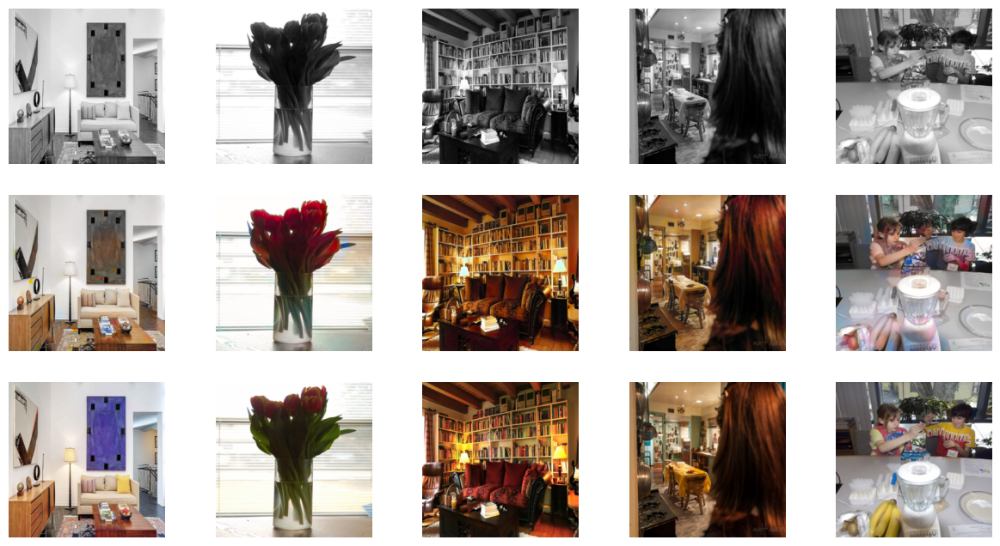

 80%|███████▉  | 199/250 [09:12<02:23,  2.82s/it]


Epoch 8/20
Iteration 200/250
disc_loss_gen: 0.62049
disc_loss_real: 0.63523
disc_loss: 0.62786
loss_G_GAN: 0.95373
loss_G_L1: 6.62194
loss_G: 7.57567


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)


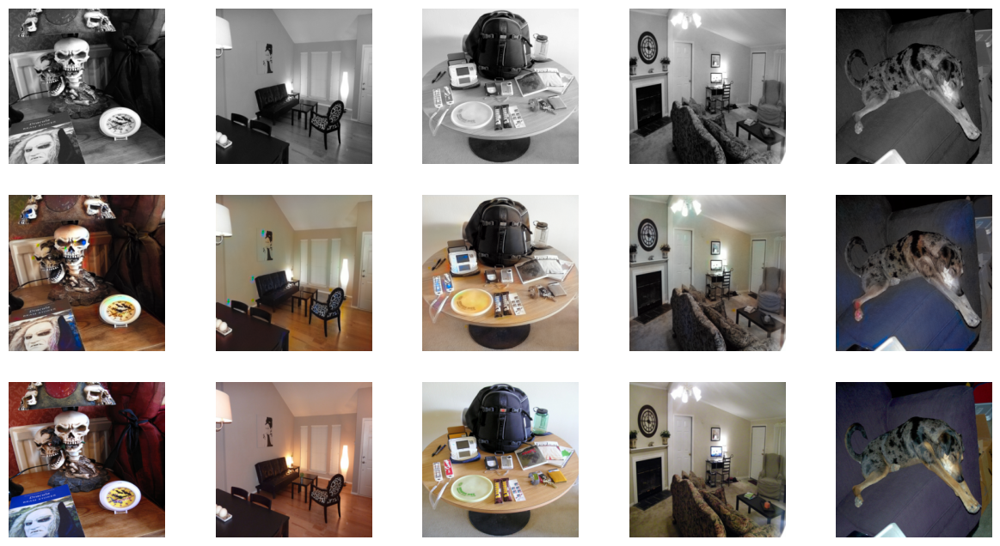

 40%|███▉      | 99/250 [04:39<07:10,  2.85s/it]


Epoch 9/20
Iteration 100/250
disc_loss_gen: 0.62317
disc_loss_real: 0.64041
disc_loss: 0.63179
loss_G_GAN: 0.94661
loss_G_L1: 6.46019
loss_G: 7.40681


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 39 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return func(*args, **kwargs)


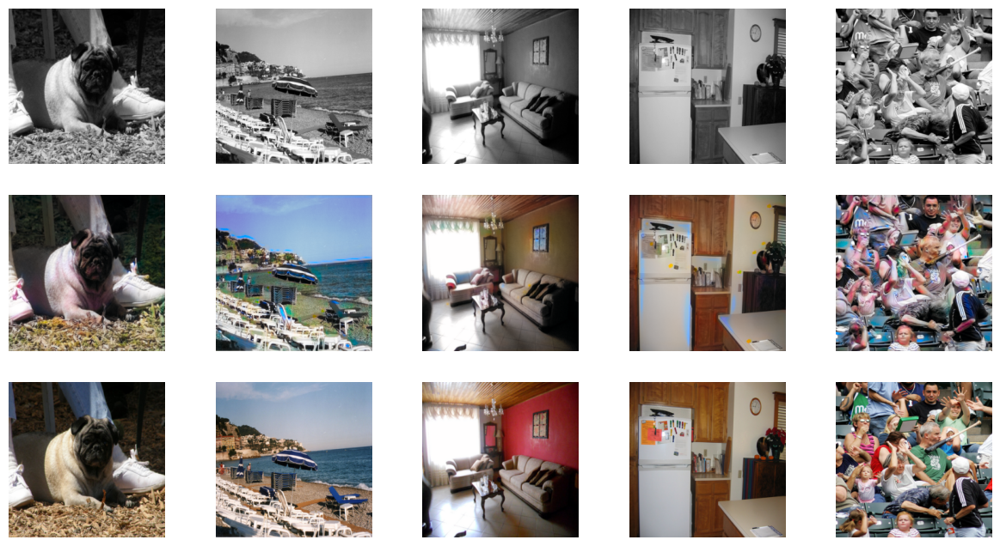

 80%|███████▉  | 199/250 [09:22<02:19,  2.74s/it]


Epoch 9/20
Iteration 200/250
disc_loss_gen: 0.62322
disc_loss_real: 0.64135
disc_loss: 0.63229
loss_G_GAN: 0.94113
loss_G_L1: 6.47947
loss_G: 7.42061


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return func(*args, **kwargs)


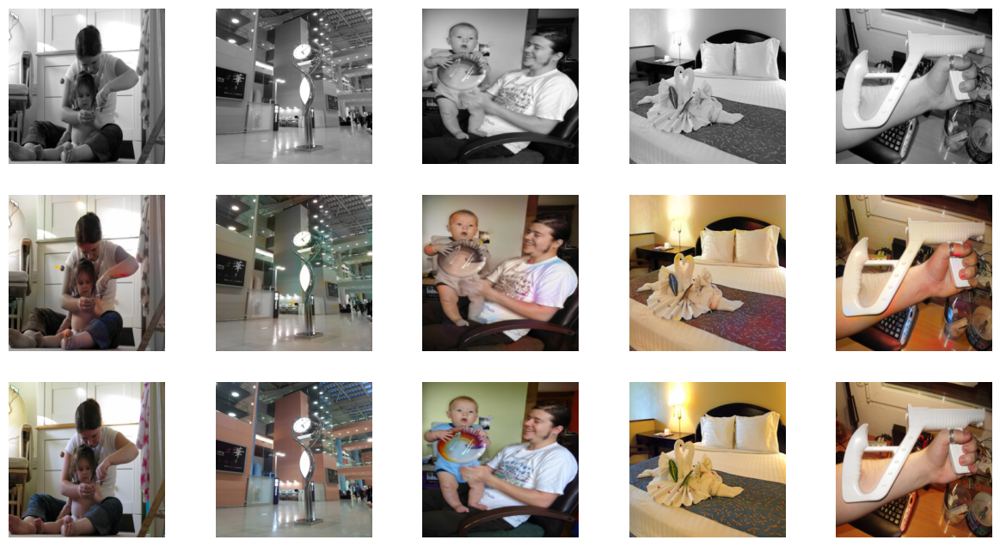

 40%|███▉      | 99/250 [04:35<06:48,  2.70s/it]


Epoch 10/20
Iteration 100/250
disc_loss_gen: 0.62298
disc_loss_real: 0.62868
disc_loss: 0.62583
loss_G_GAN: 0.93094
loss_G_L1: 6.53976
loss_G: 7.47071


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return func(*args, **kwargs)


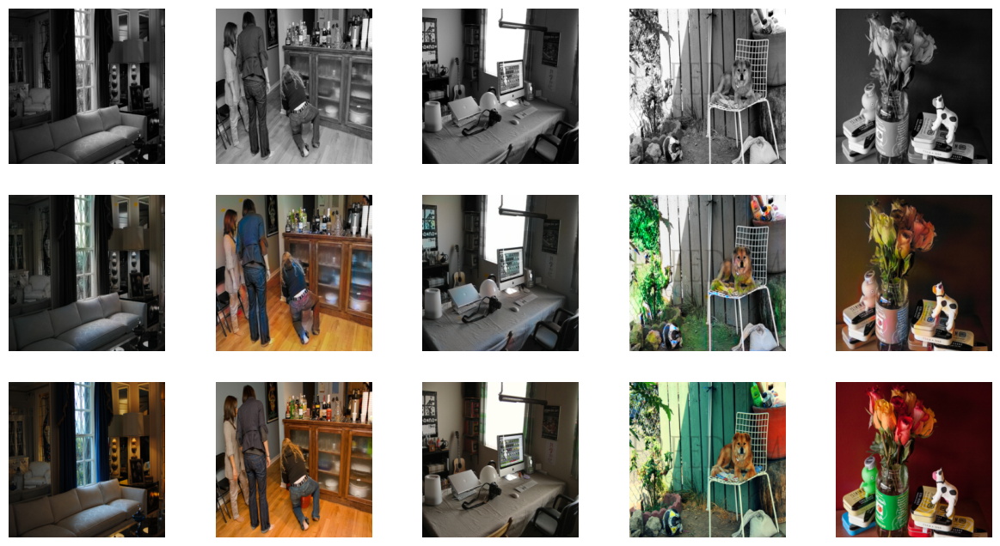

 80%|███████▉  | 199/250 [09:18<02:23,  2.81s/it]


Epoch 10/20
Iteration 200/250
disc_loss_gen: 0.62819
disc_loss_real: 0.63332
disc_loss: 0.63076
loss_G_GAN: 0.92504
loss_G_L1: 6.48716
loss_G: 7.41220


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 50 pixels
  return func(*args, **kwargs)


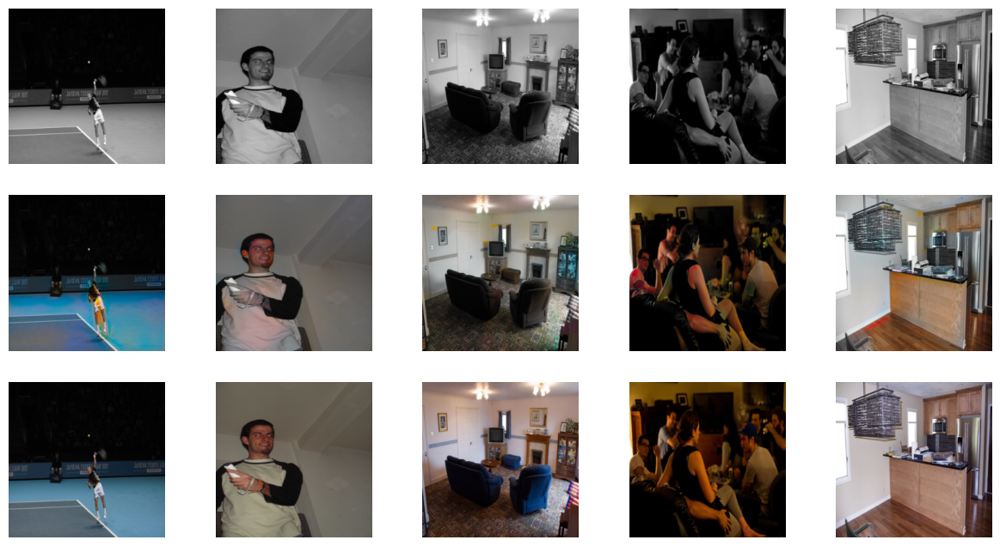

 40%|███▉      | 99/250 [04:39<07:12,  2.86s/it]


Epoch 11/20
Iteration 100/250
disc_loss_gen: 0.62694
disc_loss_real: 0.64046
disc_loss: 0.63370
loss_G_GAN: 0.90898
loss_G_L1: 6.37916
loss_G: 7.28814


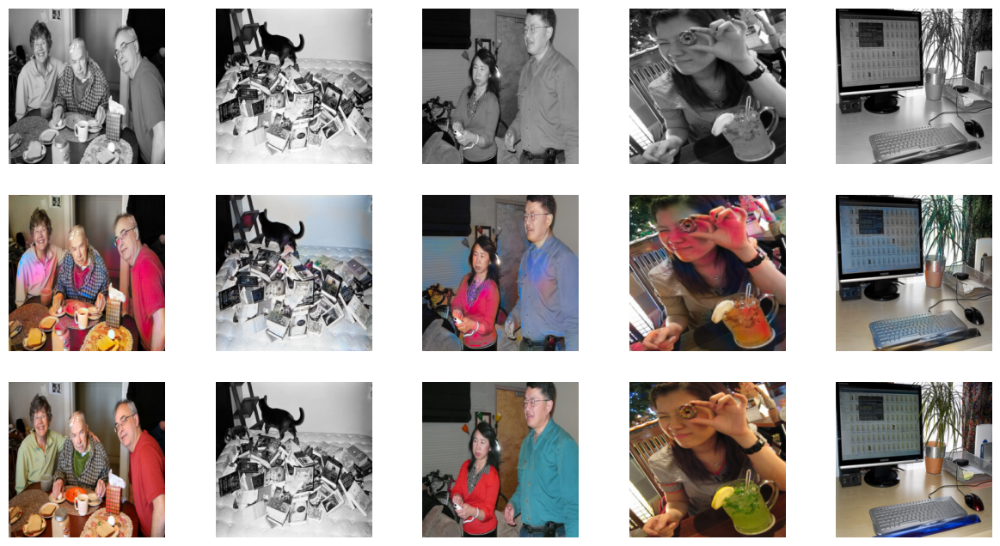

 80%|███████▉  | 199/250 [09:23<02:23,  2.82s/it]


Epoch 11/20
Iteration 200/250
disc_loss_gen: 0.62979
disc_loss_real: 0.64178
disc_loss: 0.63578
loss_G_GAN: 0.91255
loss_G_L1: 6.39516
loss_G: 7.30771


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return func(*args, **kwargs)


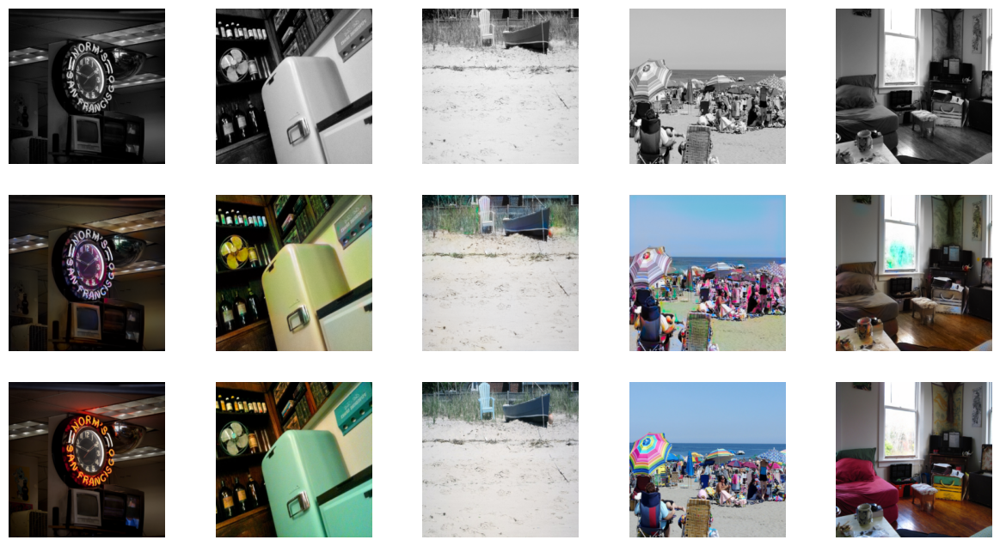

 40%|███▉      | 99/250 [04:37<06:58,  2.77s/it]


Epoch 12/20
Iteration 100/250
disc_loss_gen: 0.64066
disc_loss_real: 0.64729
disc_loss: 0.64397
loss_G_GAN: 0.89332
loss_G_L1: 6.26294
loss_G: 7.15625


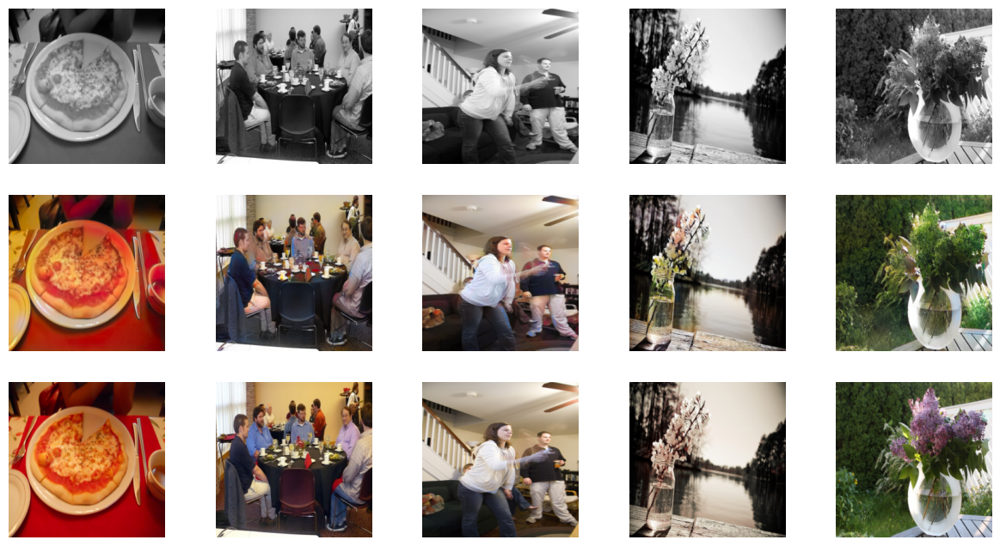

 80%|███████▉  | 199/250 [09:23<02:23,  2.82s/it]


Epoch 12/20
Iteration 200/250
disc_loss_gen: 0.63846
disc_loss_real: 0.64301
disc_loss: 0.64074
loss_G_GAN: 0.89825
loss_G_L1: 6.25332
loss_G: 7.15157


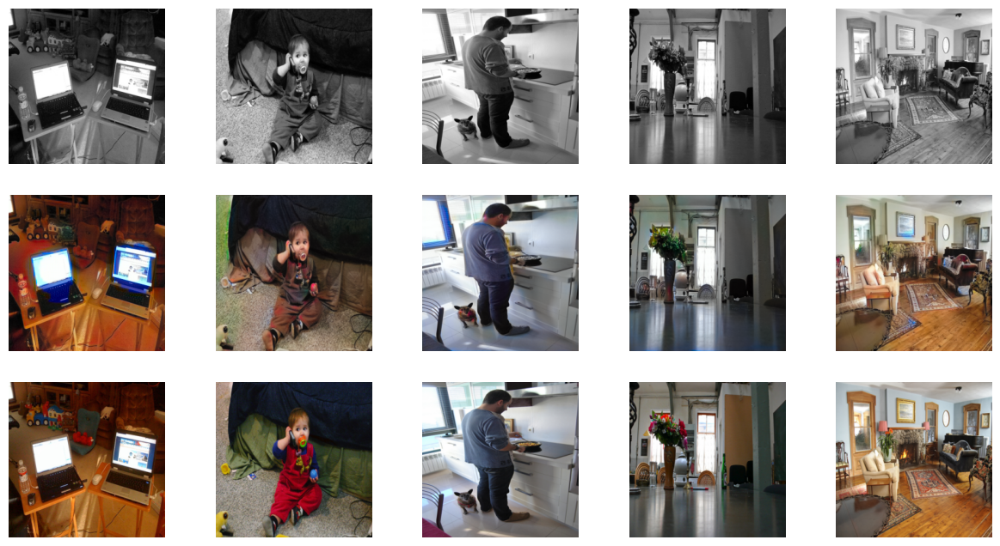

 40%|███▉      | 99/250 [04:40<07:15,  2.88s/it]


Epoch 13/20
Iteration 100/250
disc_loss_gen: 0.64264
disc_loss_real: 0.64638
disc_loss: 0.64451
loss_G_GAN: 0.88661
loss_G_L1: 6.18490
loss_G: 7.07151


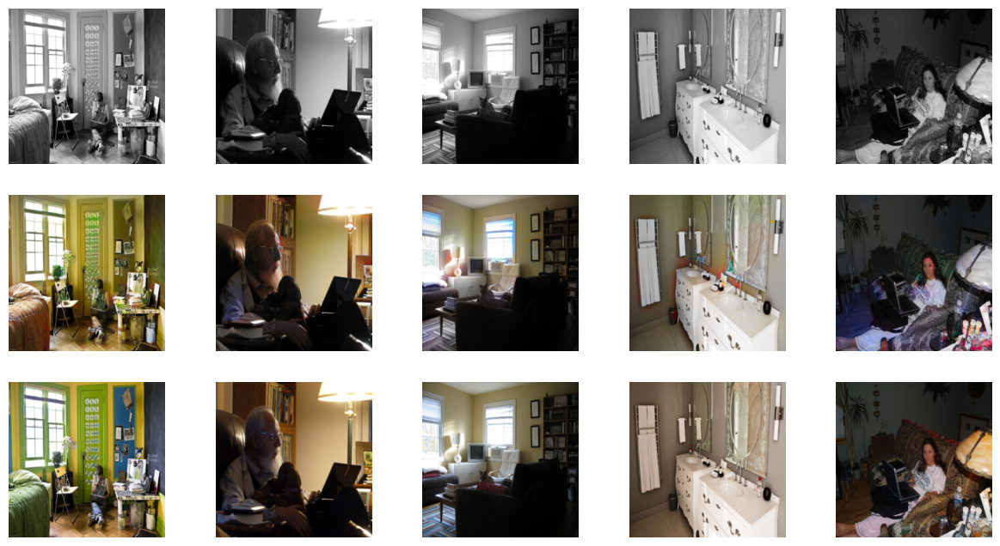

 80%|███████▉  | 199/250 [09:24<02:18,  2.72s/it]


Epoch 13/20
Iteration 200/250
disc_loss_gen: 0.63873
disc_loss_real: 0.64719
disc_loss: 0.64296
loss_G_GAN: 0.89293
loss_G_L1: 6.17878
loss_G: 7.07171


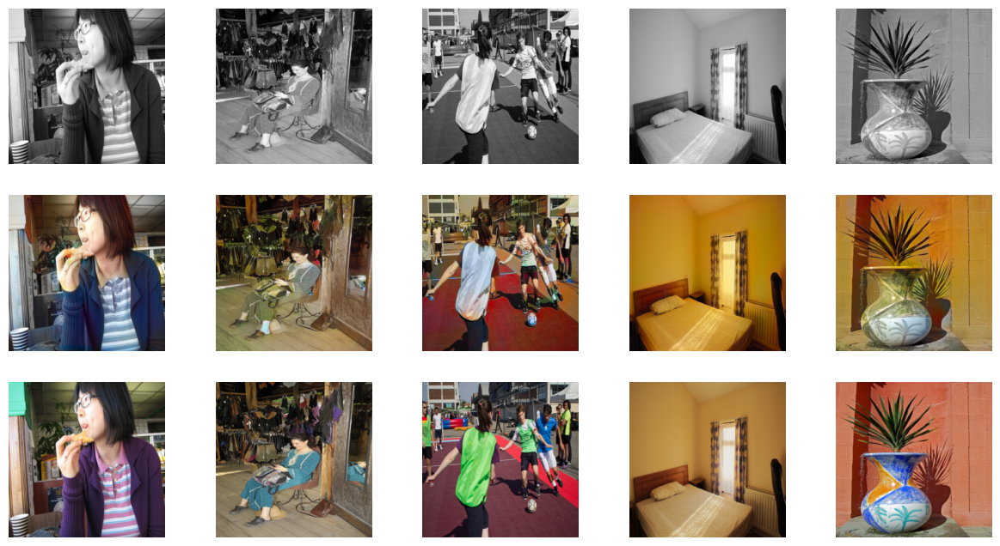

 40%|███▉      | 99/250 [04:40<07:07,  2.83s/it]


Epoch 14/20
Iteration 100/250
disc_loss_gen: 0.63401
disc_loss_real: 0.64740
disc_loss: 0.64071
loss_G_GAN: 0.87735
loss_G_L1: 6.02866
loss_G: 6.90600


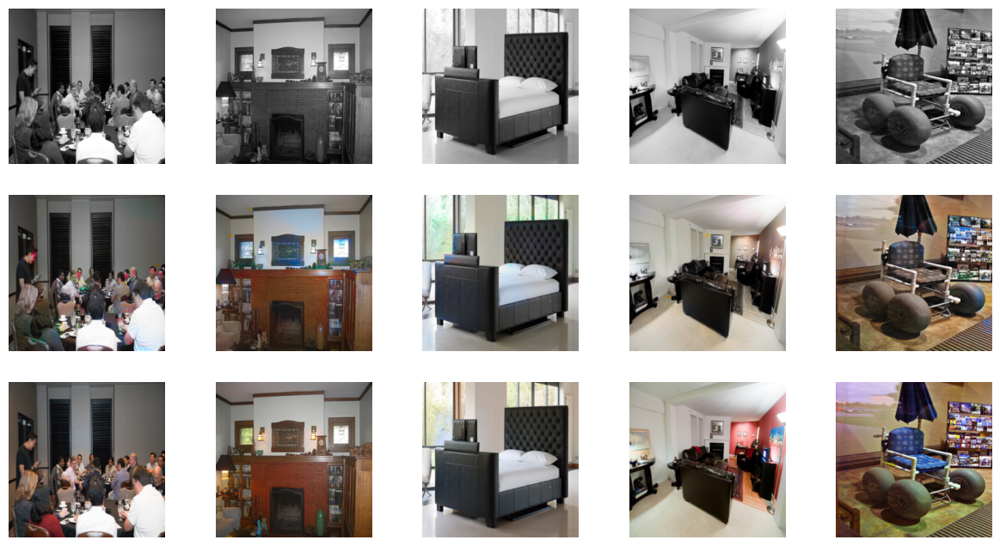

 80%|███████▉  | 199/250 [09:25<02:26,  2.87s/it]


Epoch 14/20
Iteration 200/250
disc_loss_gen: 0.63537
disc_loss_real: 0.64883
disc_loss: 0.64210
loss_G_GAN: 0.88416
loss_G_L1: 6.03376
loss_G: 6.91792


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 81 pixels
  return func(*args, **kwargs)


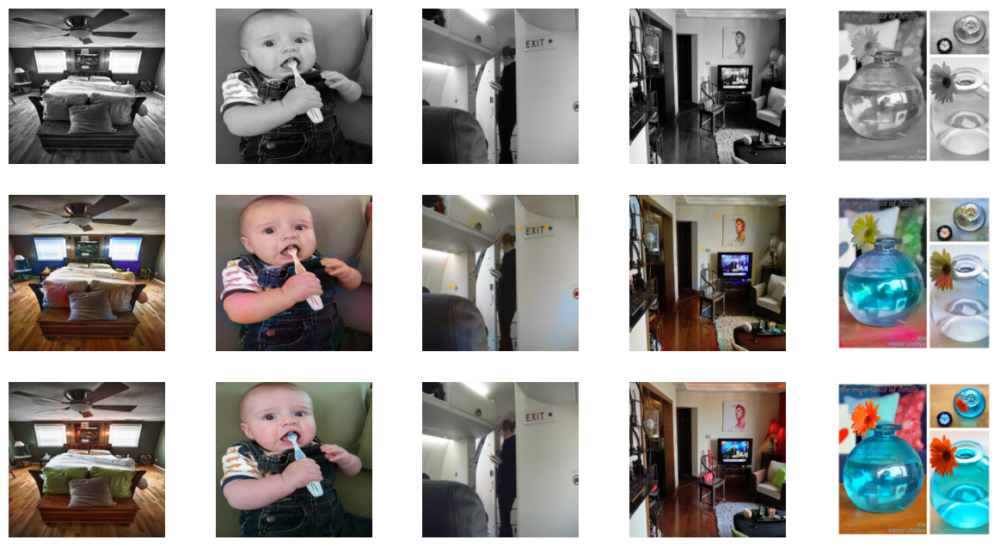

 40%|███▉      | 99/250 [04:40<07:03,  2.81s/it]


Epoch 15/20
Iteration 100/250
disc_loss_gen: 0.63201
disc_loss_real: 0.64963
disc_loss: 0.64082
loss_G_GAN: 0.88292
loss_G_L1: 5.94057
loss_G: 6.82349


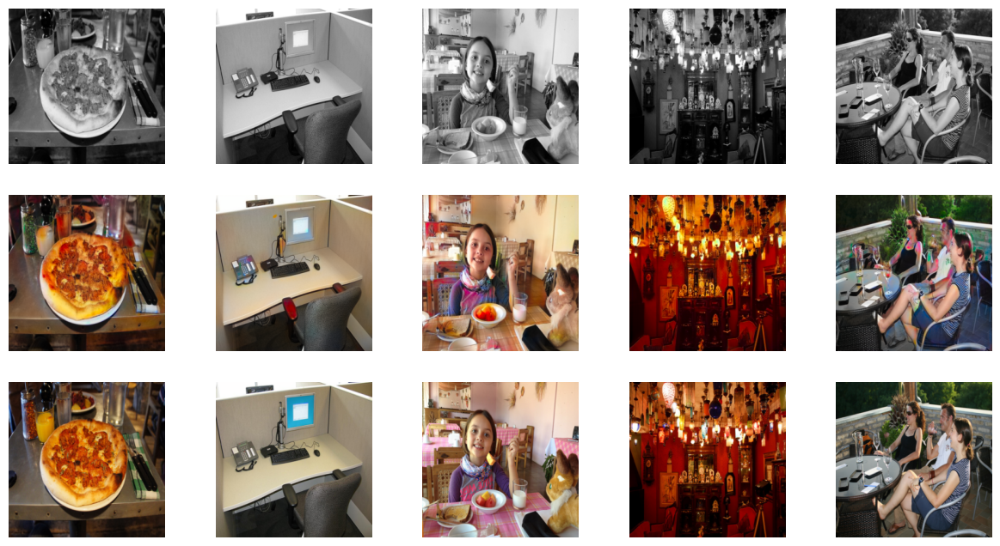

 80%|███████▉  | 199/250 [09:25<02:23,  2.82s/it]


Epoch 15/20
Iteration 200/250
disc_loss_gen: 0.63835
disc_loss_real: 0.64649
disc_loss: 0.64242
loss_G_GAN: 0.88222
loss_G_L1: 5.92522
loss_G: 6.80744


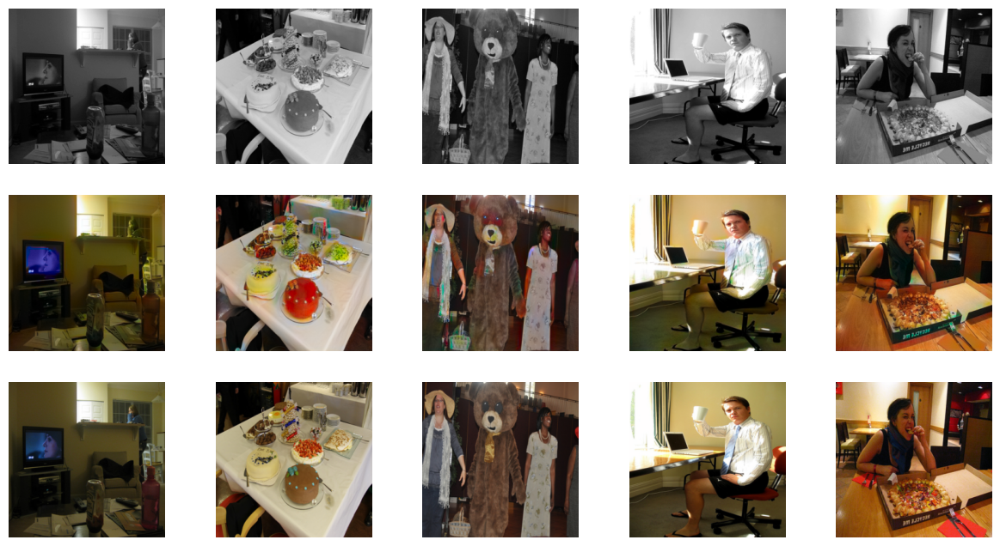

 86%|████████▌ | 214/250 [10:09<01:43,  2.88s/it]

In [ ]:
generator = build_backbone_unet(input_channels=1, output_channels=2, size=Config.image_size_1)
opt = optim.Adam(generator.parameters(), lr=Config.pretrain_lr)
loss = nn.L1Loss()        
pretrain_generator(generator, train_loader, opt, loss, Config.epochs)
torch.save(generator.state_dict(), "res18-unet.pt")
generator.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(generator=generator)
train_model(model, train_loader, Config.epochs)
torch.save(model.state_dict(), "main-model.pt")

**Model Inference**

In [ ]:
import PIL

path = "/content/image (3).jpg"
img = PIL.Image.open(path)
img = img.resize((256, 256))
img = transforms.ToTensor()(img)[:1] * 2. - 1.
model.eval()


with torch.no_grad():
    preds = model.generator(img.unsqueeze(0).to(device))
    gen_output = lab_to_rgb(img.unsqueeze(0), preds.cpu())[0]
plt.imshow(img)
plt.imshow(gen_output)